<a href="https://colab.research.google.com/github/9-coding/ComputerVision_TeamProject/blob/main/ActiveLearning2/ActiveLearning2_modelCompare_res101.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

import os
# 각자 환경에서 이 부분만 변경하여 사용하면 됩니다.
os.chdir('/content/gdrive/MyDrive/CUB_200_2011_repackage_class50')
print(os.getcwd())



Mounted at /content/gdrive/
/content/gdrive/MyDrive/CUB_200_2011_repackage_class50


In [ ]:
# !pip uninstall wandb

In [ ]:
!pip install wandb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 16.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.9/243.9 kB 20.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.3 MB/s eta 0:00:00


In [ ]:
!wandb login f9fc6c65de4904021a59f4c8c60b90961f6ec1fb

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
import time
import torch
import torchvision.transforms as transforms
import torchvision.models as models
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, ConcatDataset
from PIL import Image
import random

## wandb ###
import wandb
wandb.init(project='ActiveLearning2_modelCompare')

def set_seed(seed: int = 42) -> None:
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    # When running on the CuDNN backend, two further options must be set
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    # Set a fixed value for the hash seed
    os.environ["PYTHONHASHSEED"] = str(seed)
    print(f"Random seed set as {seed}")

set_seed(42)


### GPU Setting ###
USE_CUDA = torch.cuda.is_available()
DEVICE = torch.device("cuda" if USE_CUDA else "cpu")
print(DEVICE)

### Custom Dataset ###
class CUB2011(Dataset):
    def __init__(self, transform, mode='train'):
        self.transform = transform
        self.mode = mode
        self.image_folder = os.listdir(f'./datasets/{mode}')

    def __len__(self):
        return len(self.image_folder)

    def __getitem__(self, idx):
        img_path = self.image_folder[idx]
        img = Image.open(os.path.join('./datasets', self.mode, img_path)).convert('RGB')
        img = self.transform(img)
        label = int(img_path.split('_')[-1].split('.')[0])
        return (img, label)

wandb: Currently logged in as: kdy1021 (computervisionactivelearning). Use `wandb login --relogin` to force relogin


Random seed set as 42
cuda


In [ ]:
### Data Augmentation ###
def transforms_func(transform):
  return transforms.Compose([
    transforms.Resize((448, 448)),
    transform,
    transforms.ToTensor(),
])

def transforms_resize_func(resize):
  return transforms.Compose([
    resize,
    transforms.ToTensor(),
])

ROTATION_DEGREE = 30
zoom_scale = (0.8, 1.2)
transforms_rotation = transforms_func(transforms.RandomRotation(degrees=ROTATION_DEGREE))
transforms_horizontal_flip = transforms_func(transforms.RandomHorizontalFlip(p=1.0))
transforms_zoom = transforms_func(transforms.RandomResizedCrop(448, scale=zoom_scale))

transforms_train = transforms_resize_func(transforms.Resize((448, 448)))
transforms_valtest = transforms_resize_func(transforms.Resize((448, 448)))
transforms_random_resized_crop = transforms_resize_func(transforms.RandomResizedCrop(448, scale=(0.8, 1.0)))

In [ ]:
BATCH_SIZE = 16
EPOCH = 20
lr = 0.1

train_set = CUB2011(mode='train', transform=transforms_train)
train_set_rotation = CUB2011(mode='train', transform=transforms_rotation)
train_set_horizontal_flip = CUB2011(mode='train', transform=transforms_horizontal_flip)
train_set_randomcrop =  CUB2011(mode='train', transform=transforms_random_resized_crop)
train_set_zoom = CUB2011(mode='train', transform=transforms_zoom)

combined_train_set = ConcatDataset([train_set, train_set_rotation, train_set_horizontal_flip, train_set_zoom])

val_set = CUB2011(mode='valid', transform=transforms_valtest)
test_set = CUB2011(mode='test', transform=transforms_valtest)

train_loader = DataLoader(combined_train_set, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_set, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_set, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
import torchsummary

### Model / Optimizer ###
model = models.resnet101(pretrained=True)

num_features = model.fc.in_features

# Adjusting for augmentation
model.fc = nn.Linear(num_features, 50)
model = model.to(DEVICE)
optimizer = optim.SGD(model.parameters(), lr=lr)

print("resnet101")
print(torchsummary.summary(model, (3, 448, 448)))

resnet101
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           9,408
       BatchNorm2d-2         [-1, 64, 224, 224]             128
              ReLU-3         [-1, 64, 224, 224]               0
         MaxPool2d-4         [-1, 64, 112, 112]               0
            Conv2d-5         [-1, 64, 112, 112]           4,096
       BatchNorm2d-6         [-1, 64, 112, 112]             128
              ReLU-7         [-1, 64, 112, 112]               0
            Conv2d-8         [-1, 64, 112, 112]          36,864
       BatchNorm2d-9         [-1, 64, 112, 112]             128
             ReLU-10         [-1, 64, 112, 112]               0
           Conv2d-11        [-1, 256, 112, 112]          16,384
      BatchNorm2d-12        [-1, 256, 112, 112]             512
           Conv2d-13        [-1, 256, 112, 112]          16,384
      BatchNorm2d-14        [

In [ ]:
### Train/Evaluation ###
def train(model, train_loader, optimizer, epoch):
    model.train()
    for i, (image, target) in enumerate(train_loader):
        image, target = image.to(DEVICE), target.to(DEVICE)
        output = model(image)
        optimizer.zero_grad()
        train_loss = F.cross_entropy(output, target).to(DEVICE)
        train_loss.backward()
        optimizer.step()

        if i % 30 == 0:
            print(f'Train Epoch {epoch} [{i}/{len(train_loader)}]\tLoss: {train_loss.item():.6f}')
    return train_loss

def evaluate(model, val_loader):
    model.eval()
    eval_loss = 0
    correct = 0
    with torch.no_grad():
        for i, (image, target) in enumerate(val_loader):
            image, target = image.to(DEVICE), target.to(DEVICE)
            output = model(image)
            eval_loss += F.cross_entropy(output, target, reduction='sum').item()
            pred = output.max(1, keepdim=True)[1]
            correct += pred.eq(target.view_as(pred)).sum().item()
        eval_loss /= len(val_loader.dataset)
        eval_accuracy = 100 * correct / len(val_loader.dataset)
        return eval_loss, eval_accuracy

Train Epoch 0 [0/590]	Loss: 3.965941
Train Epoch 0 [30/590]	Loss: 3.298122
Train Epoch 0 [60/590]	Loss: 2.641786
Train Epoch 0 [90/590]	Loss: 1.943957
Train Epoch 0 [120/590]	Loss: 1.549715
Train Epoch 0 [150/590]	Loss: 1.523698
Train Epoch 0 [180/590]	Loss: 1.022933
Train Epoch 0 [210/590]	Loss: 1.279677
Train Epoch 0 [240/590]	Loss: 1.423350
Train Epoch 0 [270/590]	Loss: 0.538693
Train Epoch 0 [300/590]	Loss: 1.201781
Train Epoch 0 [330/590]	Loss: 0.788577
Train Epoch 0 [360/590]	Loss: 0.422318
Train Epoch 0 [390/590]	Loss: 0.618472
Train Epoch 0 [420/590]	Loss: 1.145555
Train Epoch 0 [450/590]	Loss: 0.539397
Train Epoch 0 [480/590]	Loss: 0.521711
Train Epoch 0 [510/590]	Loss: 0.479091
Train Epoch 0 [540/590]	Loss: 0.506528
Train Epoch 0 [570/590]	Loss: 0.539615


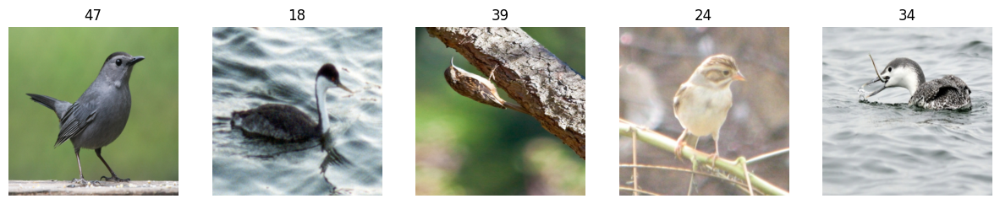

Epoch 0
Train Loss: 0.5355, Validation Loss: 1.2719, Validation Accuracy: 70.27%

Train Epoch 1 [0/590]	Loss: 0.140923
Train Epoch 1 [30/590]	Loss: 0.160184
Train Epoch 1 [60/590]	Loss: 0.154117
Train Epoch 1 [90/590]	Loss: 0.226840
Train Epoch 1 [120/590]	Loss: 0.263667
Train Epoch 1 [150/590]	Loss: 0.160704
Train Epoch 1 [180/590]	Loss: 0.301280
Train Epoch 1 [210/590]	Loss: 0.143538
Train Epoch 1 [240/590]	Loss: 0.063323
Train Epoch 1 [270/590]	Loss: 0.144201
Train Epoch 1 [300/590]	Loss: 0.393444
Train Epoch 1 [330/590]	Loss: 0.549258
Train Epoch 1 [360/590]	Loss: 0.574153
Train Epoch 1 [390/590]	Loss: 0.312458
Train Epoch 1 [420/590]	Loss: 0.134390
Train Epoch 1 [450/590]	Loss: 0.547100
Train Epoch 1 [480/590]	Loss: 0.495854
Train Epoch 1 [510/590]	Loss: 0.161219
Train Epoch 1 [540/590]	Loss: 0.112540
Train Epoch 1 [570/590]	Loss: 0.155500


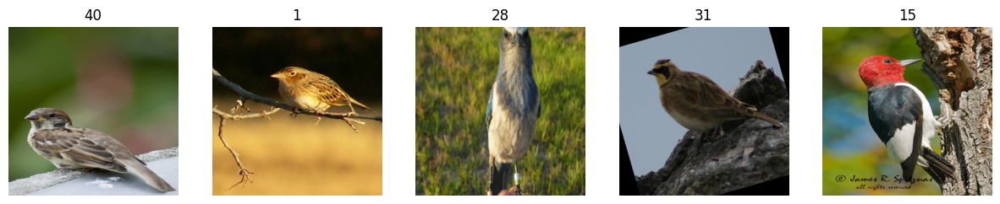

Epoch 1
Train Loss: 0.0401, Validation Loss: 0.7159, Validation Accuracy: 79.05%

Train Epoch 2 [0/590]	Loss: 0.199328
Train Epoch 2 [30/590]	Loss: 0.095092
Train Epoch 2 [60/590]	Loss: 0.142427
Train Epoch 2 [90/590]	Loss: 0.147663
Train Epoch 2 [120/590]	Loss: 0.060166
Train Epoch 2 [150/590]	Loss: 0.068720
Train Epoch 2 [180/590]	Loss: 0.016555
Train Epoch 2 [210/590]	Loss: 0.126490
Train Epoch 2 [240/590]	Loss: 0.213882
Train Epoch 2 [270/590]	Loss: 0.031017
Train Epoch 2 [300/590]	Loss: 0.309985
Train Epoch 2 [330/590]	Loss: 0.019701
Train Epoch 2 [360/590]	Loss: 0.115145
Train Epoch 2 [390/590]	Loss: 0.197930
Train Epoch 2 [420/590]	Loss: 0.193112
Train Epoch 2 [450/590]	Loss: 0.021295
Train Epoch 2 [480/590]	Loss: 0.043503
Train Epoch 2 [510/590]	Loss: 0.081390
Train Epoch 2 [540/590]	Loss: 0.024749
Train Epoch 2 [570/590]	Loss: 0.018103


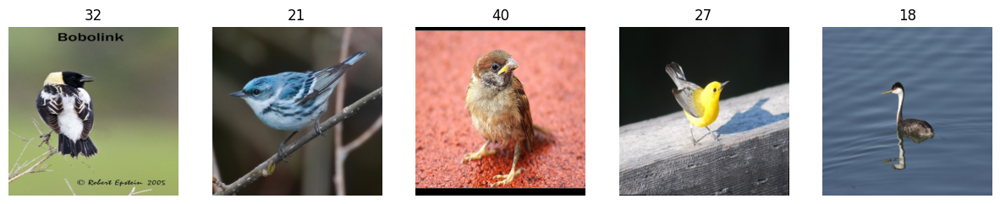

Epoch 2
Train Loss: 0.0259, Validation Loss: 0.5773, Validation Accuracy: 83.78%

Train Epoch 3 [0/590]	Loss: 0.027011
Train Epoch 3 [30/590]	Loss: 0.103235
Train Epoch 3 [60/590]	Loss: 0.397708
Train Epoch 3 [90/590]	Loss: 0.058575
Train Epoch 3 [120/590]	Loss: 0.046225
Train Epoch 3 [150/590]	Loss: 0.004242
Train Epoch 3 [180/590]	Loss: 0.015861
Train Epoch 3 [210/590]	Loss: 0.005186
Train Epoch 3 [240/590]	Loss: 0.004913
Train Epoch 3 [270/590]	Loss: 0.097367
Train Epoch 3 [300/590]	Loss: 0.123743
Train Epoch 3 [330/590]	Loss: 0.036956
Train Epoch 3 [360/590]	Loss: 0.214339
Train Epoch 3 [390/590]	Loss: 0.045544
Train Epoch 3 [420/590]	Loss: 0.118474
Train Epoch 3 [450/590]	Loss: 0.012917
Train Epoch 3 [480/590]	Loss: 0.003644
Train Epoch 3 [510/590]	Loss: 0.316893
Train Epoch 3 [540/590]	Loss: 0.558025
Train Epoch 3 [570/590]	Loss: 0.018532


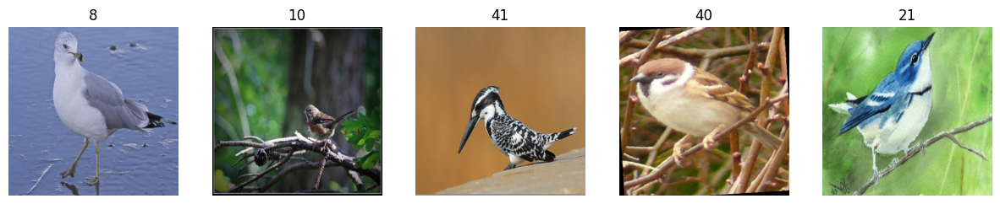

Epoch 3
Train Loss: 0.3956, Validation Loss: 1.5073, Validation Accuracy: 64.19%

Train Epoch 4 [0/590]	Loss: 0.321826
Train Epoch 4 [30/590]	Loss: 0.039947
Train Epoch 4 [60/590]	Loss: 0.098284
Train Epoch 4 [90/590]	Loss: 0.013510
Train Epoch 4 [120/590]	Loss: 0.016178
Train Epoch 4 [150/590]	Loss: 0.070003
Train Epoch 4 [180/590]	Loss: 0.002912
Train Epoch 4 [210/590]	Loss: 0.019827
Train Epoch 4 [240/590]	Loss: 0.112003
Train Epoch 4 [270/590]	Loss: 0.223981
Train Epoch 4 [300/590]	Loss: 0.276673
Train Epoch 4 [330/590]	Loss: 0.035595
Train Epoch 4 [360/590]	Loss: 0.111693
Train Epoch 4 [390/590]	Loss: 0.099653
Train Epoch 4 [420/590]	Loss: 0.011597
Train Epoch 4 [450/590]	Loss: 0.020691
Train Epoch 4 [480/590]	Loss: 0.012079
Train Epoch 4 [510/590]	Loss: 0.024333
Train Epoch 4 [540/590]	Loss: 0.003430
Train Epoch 4 [570/590]	Loss: 0.118619


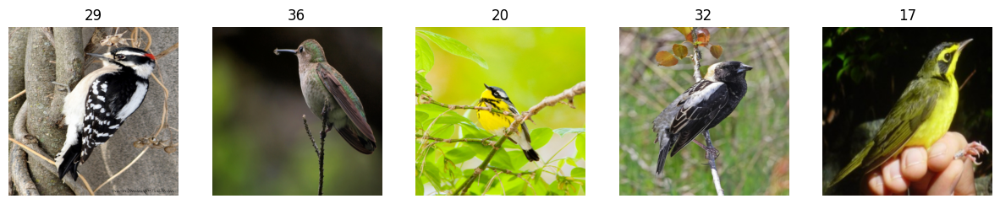

Epoch 4
Train Loss: 0.0746, Validation Loss: 0.4852, Validation Accuracy: 87.16%

Train Epoch 5 [0/590]	Loss: 0.077102
Train Epoch 5 [30/590]	Loss: 0.003343
Train Epoch 5 [60/590]	Loss: 0.005176
Train Epoch 5 [90/590]	Loss: 0.060697
Train Epoch 5 [120/590]	Loss: 0.009472
Train Epoch 5 [150/590]	Loss: 0.080544
Train Epoch 5 [180/590]	Loss: 0.083745
Train Epoch 5 [210/590]	Loss: 0.077168
Train Epoch 5 [240/590]	Loss: 0.005826
Train Epoch 5 [270/590]	Loss: 0.002039
Train Epoch 5 [300/590]	Loss: 0.001846
Train Epoch 5 [330/590]	Loss: 0.032285
Train Epoch 5 [360/590]	Loss: 0.022749
Train Epoch 5 [390/590]	Loss: 0.057059
Train Epoch 5 [420/590]	Loss: 0.246916
Train Epoch 5 [450/590]	Loss: 0.013147
Train Epoch 5 [480/590]	Loss: 0.000459
Train Epoch 5 [510/590]	Loss: 0.015515
Train Epoch 5 [540/590]	Loss: 0.002771
Train Epoch 5 [570/590]	Loss: 0.289135


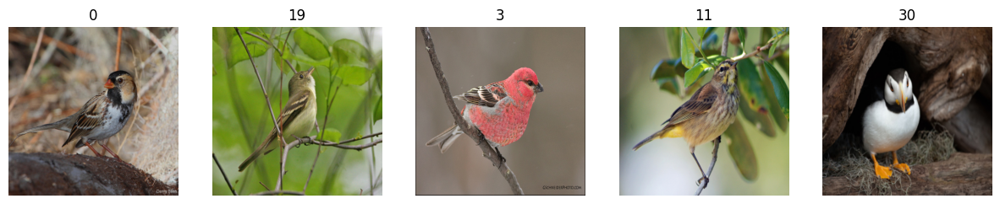

Epoch 5
Train Loss: 0.0878, Validation Loss: 0.4496, Validation Accuracy: 89.19%

Train Epoch 6 [0/590]	Loss: 0.040769
Train Epoch 6 [30/590]	Loss: 0.002161
Train Epoch 6 [60/590]	Loss: 0.002517
Train Epoch 6 [90/590]	Loss: 0.094745
Train Epoch 6 [120/590]	Loss: 0.007044
Train Epoch 6 [150/590]	Loss: 0.005323
Train Epoch 6 [180/590]	Loss: 0.067971
Train Epoch 6 [210/590]	Loss: 0.002116
Train Epoch 6 [240/590]	Loss: 0.169770
Train Epoch 6 [270/590]	Loss: 0.054586
Train Epoch 6 [300/590]	Loss: 0.030233
Train Epoch 6 [330/590]	Loss: 0.054758
Train Epoch 6 [360/590]	Loss: 0.147636
Train Epoch 6 [390/590]	Loss: 0.013890
Train Epoch 6 [420/590]	Loss: 0.011157
Train Epoch 6 [450/590]	Loss: 0.001388
Train Epoch 6 [480/590]	Loss: 0.006570
Train Epoch 6 [510/590]	Loss: 0.001631
Train Epoch 6 [540/590]	Loss: 0.000369
Train Epoch 6 [570/590]	Loss: 0.001139


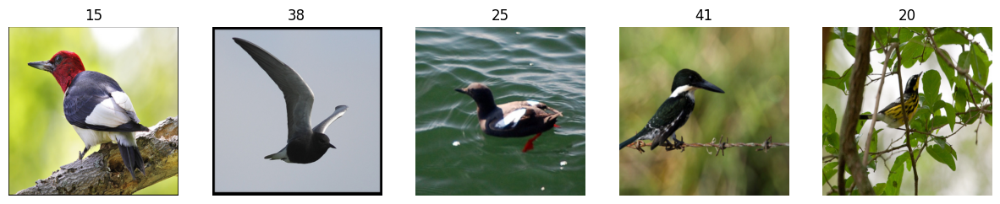

Epoch 6
Train Loss: 0.0041, Validation Loss: 0.3437, Validation Accuracy: 92.91%

Train Epoch 7 [0/590]	Loss: 0.001093
Train Epoch 7 [30/590]	Loss: 0.000621
Train Epoch 7 [60/590]	Loss: 0.000860
Train Epoch 7 [90/590]	Loss: 0.007487
Train Epoch 7 [120/590]	Loss: 0.001031
Train Epoch 7 [150/590]	Loss: 0.062045
Train Epoch 7 [180/590]	Loss: 0.035819
Train Epoch 7 [210/590]	Loss: 0.006004
Train Epoch 7 [240/590]	Loss: 0.008314
Train Epoch 7 [270/590]	Loss: 0.022004
Train Epoch 7 [300/590]	Loss: 0.617101
Train Epoch 7 [330/590]	Loss: 0.002093
Train Epoch 7 [360/590]	Loss: 0.146964
Train Epoch 7 [390/590]	Loss: 0.005740
Train Epoch 7 [420/590]	Loss: 0.004106
Train Epoch 7 [450/590]	Loss: 0.021853
Train Epoch 7 [480/590]	Loss: 0.016843
Train Epoch 7 [510/590]	Loss: 0.002569
Train Epoch 7 [540/590]	Loss: 0.004560
Train Epoch 7 [570/590]	Loss: 0.002519


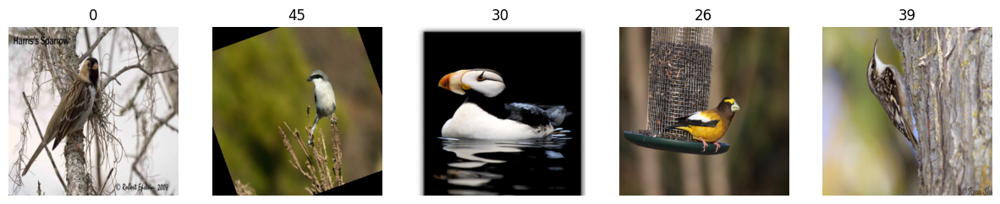

Epoch 7
Train Loss: 0.0044, Validation Loss: 0.4337, Validation Accuracy: 90.54%

Train Epoch 8 [0/590]	Loss: 0.022093
Train Epoch 8 [30/590]	Loss: 0.000863
Train Epoch 8 [60/590]	Loss: 0.003136
Train Epoch 8 [90/590]	Loss: 0.027114
Train Epoch 8 [120/590]	Loss: 0.003226
Train Epoch 8 [150/590]	Loss: 0.003541
Train Epoch 8 [180/590]	Loss: 0.001477
Train Epoch 8 [210/590]	Loss: 0.000709
Train Epoch 8 [240/590]	Loss: 0.000430
Train Epoch 8 [270/590]	Loss: 0.000652
Train Epoch 8 [300/590]	Loss: 0.000485
Train Epoch 8 [330/590]	Loss: 0.011469
Train Epoch 8 [360/590]	Loss: 0.002252
Train Epoch 8 [390/590]	Loss: 0.000355
Train Epoch 8 [420/590]	Loss: 0.002020
Train Epoch 8 [450/590]	Loss: 0.057699
Train Epoch 8 [480/590]	Loss: 0.011833
Train Epoch 8 [510/590]	Loss: 0.000740
Train Epoch 8 [540/590]	Loss: 0.102004
Train Epoch 8 [570/590]	Loss: 0.089826


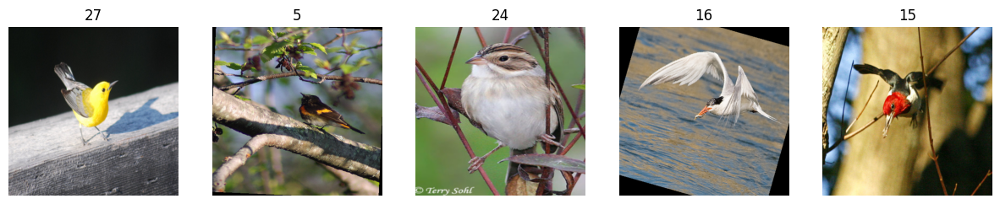

Epoch 8
Train Loss: 0.0066, Validation Loss: 0.6326, Validation Accuracy: 86.49%

Train Epoch 9 [0/590]	Loss: 0.004157
Train Epoch 9 [30/590]	Loss: 0.002057
Train Epoch 9 [60/590]	Loss: 0.007474
Train Epoch 9 [90/590]	Loss: 0.000300
Train Epoch 9 [120/590]	Loss: 0.016301
Train Epoch 9 [150/590]	Loss: 0.005154
Train Epoch 9 [180/590]	Loss: 0.001754
Train Epoch 9 [210/590]	Loss: 0.004785
Train Epoch 9 [240/590]	Loss: 0.007483
Train Epoch 9 [270/590]	Loss: 0.000644
Train Epoch 9 [300/590]	Loss: 0.000302
Train Epoch 9 [330/590]	Loss: 0.001448
Train Epoch 9 [360/590]	Loss: 0.000198
Train Epoch 9 [390/590]	Loss: 0.000158
Train Epoch 9 [420/590]	Loss: 0.000789
Train Epoch 9 [450/590]	Loss: 0.001108
Train Epoch 9 [480/590]	Loss: 0.000225
Train Epoch 9 [510/590]	Loss: 0.000252
Train Epoch 9 [540/590]	Loss: 0.000677
Train Epoch 9 [570/590]	Loss: 0.000976


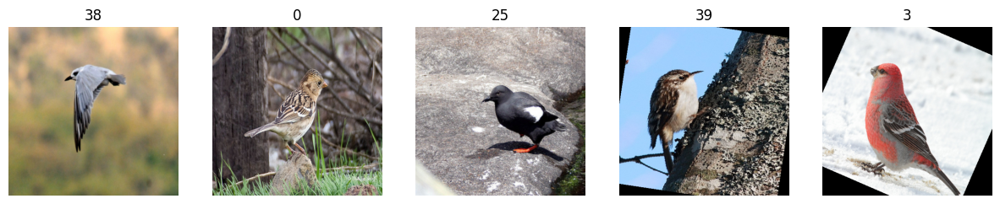

Epoch 9
Train Loss: 0.0005, Validation Loss: 0.3304, Validation Accuracy: 92.91%

Train Epoch 10 [0/590]	Loss: 0.008680
Train Epoch 10 [30/590]	Loss: 0.000043
Train Epoch 10 [60/590]	Loss: 0.000337
Train Epoch 10 [90/590]	Loss: 0.002884
Train Epoch 10 [120/590]	Loss: 0.000045
Train Epoch 10 [150/590]	Loss: 0.000255
Train Epoch 10 [180/590]	Loss: 0.000254
Train Epoch 10 [210/590]	Loss: 0.001704
Train Epoch 10 [240/590]	Loss: 0.000535
Train Epoch 10 [270/590]	Loss: 0.002133
Train Epoch 10 [300/590]	Loss: 0.001327
Train Epoch 10 [330/590]	Loss: 0.000393
Train Epoch 10 [360/590]	Loss: 0.000812
Train Epoch 10 [390/590]	Loss: 0.000223
Train Epoch 10 [420/590]	Loss: 0.000977
Train Epoch 10 [450/590]	Loss: 0.000307
Train Epoch 10 [480/590]	Loss: 0.001571
Train Epoch 10 [510/590]	Loss: 0.000908
Train Epoch 10 [540/590]	Loss: 0.000690
Train Epoch 10 [570/590]	Loss: 0.002165


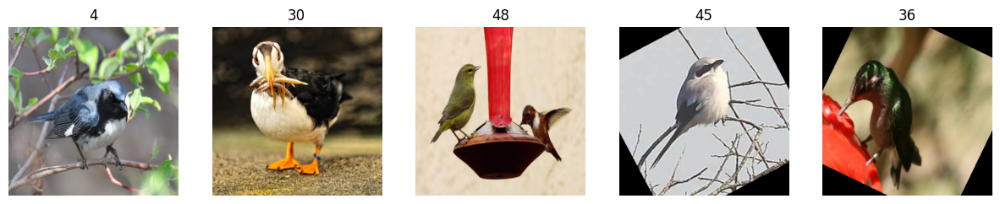

Epoch 10
Train Loss: 0.0004, Validation Loss: 0.4922, Validation Accuracy: 90.20%

Train Epoch 11 [0/590]	Loss: 0.000388
Train Epoch 11 [30/590]	Loss: 0.005321
Train Epoch 11 [60/590]	Loss: 0.003687
Train Epoch 11 [90/590]	Loss: 0.006639
Train Epoch 11 [120/590]	Loss: 0.000370
Train Epoch 11 [150/590]	Loss: 0.001272
Train Epoch 11 [180/590]	Loss: 0.001059
Train Epoch 11 [210/590]	Loss: 0.000564
Train Epoch 11 [240/590]	Loss: 0.000811
Train Epoch 11 [270/590]	Loss: 0.001738
Train Epoch 11 [300/590]	Loss: 0.000207
Train Epoch 11 [330/590]	Loss: 0.000881
Train Epoch 11 [360/590]	Loss: 0.000195
Train Epoch 11 [390/590]	Loss: 0.000792
Train Epoch 11 [420/590]	Loss: 0.000228
Train Epoch 11 [450/590]	Loss: 0.000283
Train Epoch 11 [480/590]	Loss: 0.000242
Train Epoch 11 [510/590]	Loss: 0.001523
Train Epoch 11 [540/590]	Loss: 0.000635
Train Epoch 11 [570/590]	Loss: 0.001227


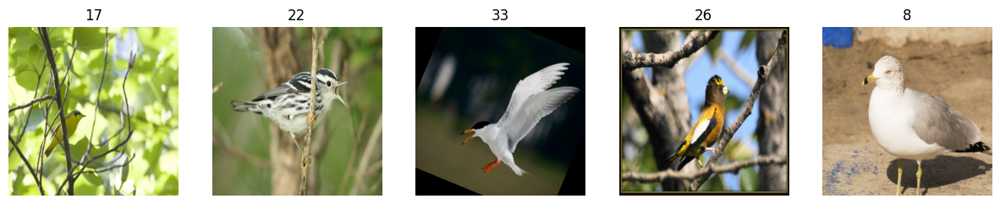

Epoch 11
Train Loss: 0.0001, Validation Loss: 0.3065, Validation Accuracy: 93.24%

Train Epoch 12 [0/590]	Loss: 0.001387
Train Epoch 12 [30/590]	Loss: 0.003122
Train Epoch 12 [60/590]	Loss: 0.000242
Train Epoch 12 [90/590]	Loss: 0.000687
Train Epoch 12 [120/590]	Loss: 0.000326
Train Epoch 12 [150/590]	Loss: 0.000674
Train Epoch 12 [180/590]	Loss: 0.000117
Train Epoch 12 [210/590]	Loss: 0.000820
Train Epoch 12 [240/590]	Loss: 0.000066
Train Epoch 12 [270/590]	Loss: 0.000200
Train Epoch 12 [300/590]	Loss: 0.000445
Train Epoch 12 [330/590]	Loss: 0.001143
Train Epoch 12 [360/590]	Loss: 0.000892
Train Epoch 12 [390/590]	Loss: 0.000222
Train Epoch 12 [420/590]	Loss: 0.000810
Train Epoch 12 [450/590]	Loss: 0.000163
Train Epoch 12 [480/590]	Loss: 0.001339
Train Epoch 12 [510/590]	Loss: 0.000138
Train Epoch 12 [540/590]	Loss: 0.000045
Train Epoch 12 [570/590]	Loss: 0.000246


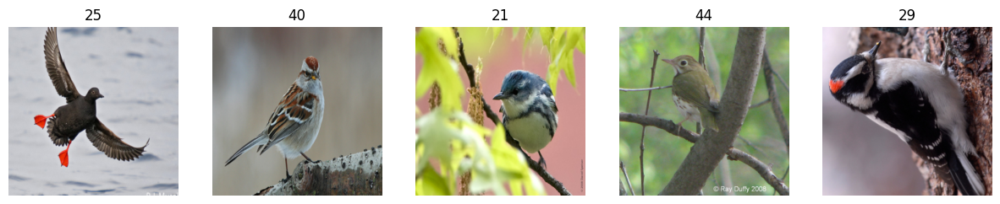

Epoch 12
Train Loss: 0.0003, Validation Loss: 0.3260, Validation Accuracy: 93.58%

Train Epoch 13 [0/590]	Loss: 0.000654
Train Epoch 13 [30/590]	Loss: 0.001785
Train Epoch 13 [60/590]	Loss: 0.000241
Train Epoch 13 [90/590]	Loss: 0.000130
Train Epoch 13 [120/590]	Loss: 0.001642
Train Epoch 13 [150/590]	Loss: 0.000118
Train Epoch 13 [180/590]	Loss: 0.000356
Train Epoch 13 [210/590]	Loss: 0.000970
Train Epoch 13 [240/590]	Loss: 0.000150
Train Epoch 13 [270/590]	Loss: 0.002750
Train Epoch 13 [300/590]	Loss: 0.000081
Train Epoch 13 [330/590]	Loss: 0.000143
Train Epoch 13 [360/590]	Loss: 0.000134
Train Epoch 13 [390/590]	Loss: 0.000244
Train Epoch 13 [420/590]	Loss: 0.000075
Train Epoch 13 [450/590]	Loss: 0.000318
Train Epoch 13 [480/590]	Loss: 0.000147
Train Epoch 13 [510/590]	Loss: 0.002863
Train Epoch 13 [540/590]	Loss: 0.000991
Train Epoch 13 [570/590]	Loss: 0.000096


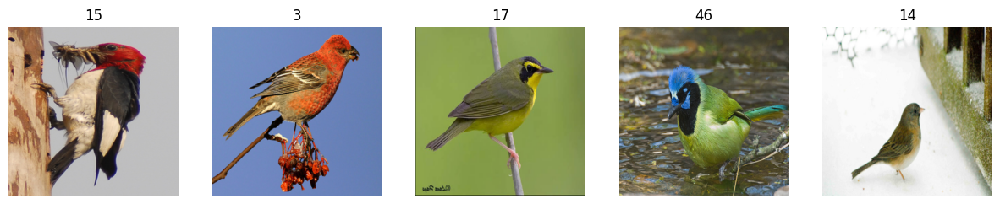

Epoch 13
Train Loss: 0.0001, Validation Loss: 0.3223, Validation Accuracy: 94.26%

Train Epoch 14 [0/590]	Loss: 0.000274
Train Epoch 14 [30/590]	Loss: 0.000798
Train Epoch 14 [60/590]	Loss: 0.000467
Train Epoch 14 [90/590]	Loss: 0.000176
Train Epoch 14 [120/590]	Loss: 0.000097
Train Epoch 14 [150/590]	Loss: 0.000097
Train Epoch 14 [180/590]	Loss: 0.000393
Train Epoch 14 [210/590]	Loss: 0.000160
Train Epoch 14 [240/590]	Loss: 0.000079
Train Epoch 14 [270/590]	Loss: 0.000348
Train Epoch 14 [300/590]	Loss: 0.000060
Train Epoch 14 [330/590]	Loss: 0.000212
Train Epoch 14 [360/590]	Loss: 0.000709
Train Epoch 14 [390/590]	Loss: 0.000298
Train Epoch 14 [420/590]	Loss: 0.017064
Train Epoch 14 [450/590]	Loss: 0.000175
Train Epoch 14 [480/590]	Loss: 0.000031
Train Epoch 14 [510/590]	Loss: 0.000310
Train Epoch 14 [540/590]	Loss: 0.000158
Train Epoch 14 [570/590]	Loss: 0.002542


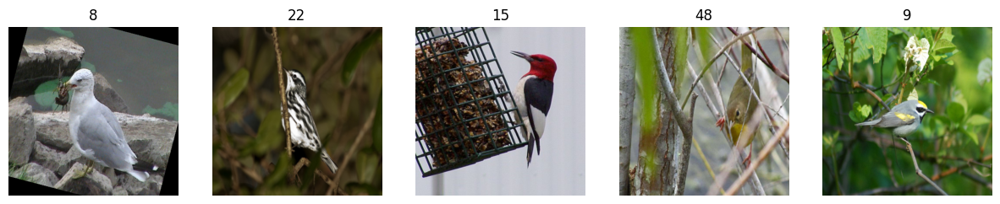

Epoch 14
Train Loss: 0.0001, Validation Loss: 0.3237, Validation Accuracy: 94.26%

Train Epoch 15 [0/590]	Loss: 0.000118
Train Epoch 15 [30/590]	Loss: 0.000132
Train Epoch 15 [60/590]	Loss: 0.000129
Train Epoch 15 [90/590]	Loss: 0.001913
Train Epoch 15 [120/590]	Loss: 0.000654
Train Epoch 15 [150/590]	Loss: 0.000076
Train Epoch 15 [180/590]	Loss: 0.000109
Train Epoch 15 [210/590]	Loss: 0.000102
Train Epoch 15 [240/590]	Loss: 0.033308
Train Epoch 15 [270/590]	Loss: 0.000146
Train Epoch 15 [300/590]	Loss: 0.000041
Train Epoch 15 [330/590]	Loss: 0.000083
Train Epoch 15 [360/590]	Loss: 0.001714
Train Epoch 15 [390/590]	Loss: 0.000338
Train Epoch 15 [420/590]	Loss: 0.000047
Train Epoch 15 [450/590]	Loss: 0.000462
Train Epoch 15 [480/590]	Loss: 0.000106
Train Epoch 15 [510/590]	Loss: 0.000255
Train Epoch 15 [540/590]	Loss: 0.000308
Train Epoch 15 [570/590]	Loss: 0.000198


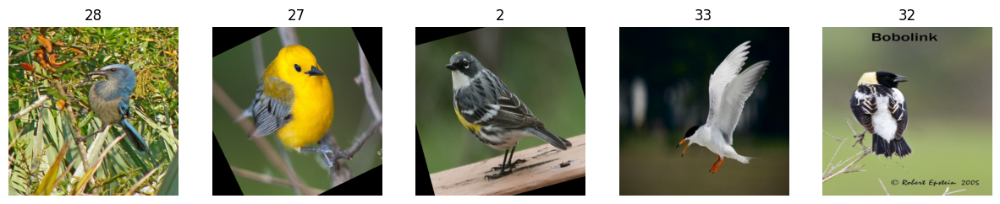

Epoch 15
Train Loss: 0.0010, Validation Loss: 0.3189, Validation Accuracy: 92.91%

Train Epoch 16 [0/590]	Loss: 0.000106
Train Epoch 16 [30/590]	Loss: 0.000220
Train Epoch 16 [60/590]	Loss: 0.000211
Train Epoch 16 [90/590]	Loss: 0.000946
Train Epoch 16 [120/590]	Loss: 0.000990
Train Epoch 16 [150/590]	Loss: 0.000105
Train Epoch 16 [180/590]	Loss: 0.013183
Train Epoch 16 [210/590]	Loss: 0.000559
Train Epoch 16 [240/590]	Loss: 0.000062
Train Epoch 16 [270/590]	Loss: 0.000428
Train Epoch 16 [300/590]	Loss: 0.000124
Train Epoch 16 [330/590]	Loss: 0.000172
Train Epoch 16 [360/590]	Loss: 0.000169
Train Epoch 16 [390/590]	Loss: 0.000677
Train Epoch 16 [420/590]	Loss: 0.000099
Train Epoch 16 [450/590]	Loss: 0.000096
Train Epoch 16 [480/590]	Loss: 0.000074
Train Epoch 16 [510/590]	Loss: 0.000155
Train Epoch 16 [540/590]	Loss: 0.000066
Train Epoch 16 [570/590]	Loss: 0.006240


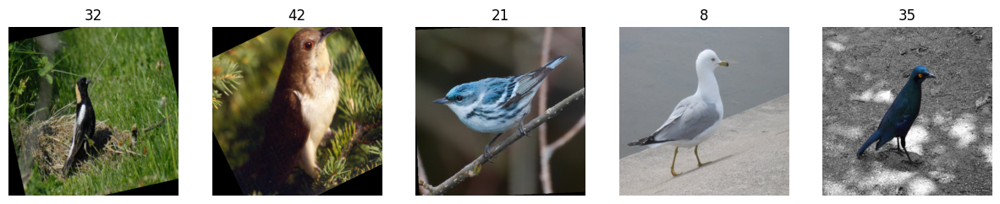

Epoch 16
Train Loss: 0.0005, Validation Loss: 0.2832, Validation Accuracy: 92.91%

Train Epoch 17 [0/590]	Loss: 0.005440
Train Epoch 17 [30/590]	Loss: 0.000205
Train Epoch 17 [60/590]	Loss: 0.000537
Train Epoch 17 [90/590]	Loss: 0.000999
Train Epoch 17 [120/590]	Loss: 0.000083
Train Epoch 17 [150/590]	Loss: 0.003288
Train Epoch 17 [180/590]	Loss: 0.000094
Train Epoch 17 [210/590]	Loss: 0.000095
Train Epoch 17 [240/590]	Loss: 0.000063
Train Epoch 17 [270/590]	Loss: 0.000935
Train Epoch 17 [300/590]	Loss: 0.000078
Train Epoch 17 [330/590]	Loss: 0.000716
Train Epoch 17 [360/590]	Loss: 0.000174
Train Epoch 17 [390/590]	Loss: 0.000046
Train Epoch 17 [420/590]	Loss: 0.000483
Train Epoch 17 [450/590]	Loss: 0.000032
Train Epoch 17 [480/590]	Loss: 0.000028
Train Epoch 17 [510/590]	Loss: 0.000074
Train Epoch 17 [540/590]	Loss: 0.000095
Train Epoch 17 [570/590]	Loss: 0.000205


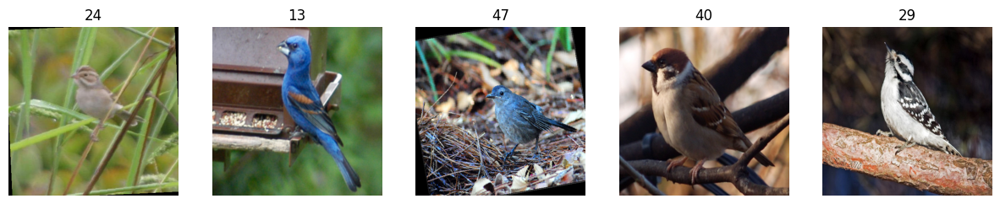

Epoch 17
Train Loss: 0.0000, Validation Loss: 0.2962, Validation Accuracy: 93.92%

Train Epoch 18 [0/590]	Loss: 0.002255
Train Epoch 18 [30/590]	Loss: 0.000090
Train Epoch 18 [60/590]	Loss: 0.000466
Train Epoch 18 [90/590]	Loss: 0.000047
Train Epoch 18 [120/590]	Loss: 0.000090
Train Epoch 18 [150/590]	Loss: 0.000211
Train Epoch 18 [180/590]	Loss: 0.000106
Train Epoch 18 [210/590]	Loss: 0.000295
Train Epoch 18 [240/590]	Loss: 0.000152
Train Epoch 18 [270/590]	Loss: 0.000108
Train Epoch 18 [300/590]	Loss: 0.000045
Train Epoch 18 [330/590]	Loss: 0.000055
Train Epoch 18 [360/590]	Loss: 0.000413
Train Epoch 18 [390/590]	Loss: 0.000053
Train Epoch 18 [420/590]	Loss: 0.000173
Train Epoch 18 [450/590]	Loss: 0.000215
Train Epoch 18 [480/590]	Loss: 0.000036
Train Epoch 18 [510/590]	Loss: 0.000042
Train Epoch 18 [540/590]	Loss: 0.000087
Train Epoch 18 [570/590]	Loss: 0.000050


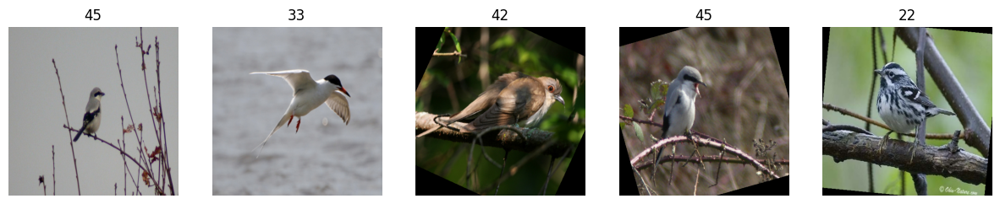

Epoch 18
Train Loss: 0.0001, Validation Loss: 0.3069, Validation Accuracy: 93.58%

Train Epoch 19 [0/590]	Loss: 0.000039
Train Epoch 19 [30/590]	Loss: 0.000704
Train Epoch 19 [60/590]	Loss: 0.000381
Train Epoch 19 [90/590]	Loss: 0.000394
Train Epoch 19 [120/590]	Loss: 0.000116
Train Epoch 19 [150/590]	Loss: 0.005411
Train Epoch 19 [180/590]	Loss: 0.000233
Train Epoch 19 [210/590]	Loss: 0.000271
Train Epoch 19 [240/590]	Loss: 0.000114
Train Epoch 19 [270/590]	Loss: 0.000061
Train Epoch 19 [300/590]	Loss: 0.000056
Train Epoch 19 [330/590]	Loss: 0.000022
Train Epoch 19 [360/590]	Loss: 0.013322
Train Epoch 19 [390/590]	Loss: 0.000089
Train Epoch 19 [420/590]	Loss: 0.000079
Train Epoch 19 [450/590]	Loss: 0.000055
Train Epoch 19 [480/590]	Loss: 0.009004
Train Epoch 19 [510/590]	Loss: 0.000294
Train Epoch 19 [540/590]	Loss: 0.000098
Train Epoch 19 [570/590]	Loss: 0.000530


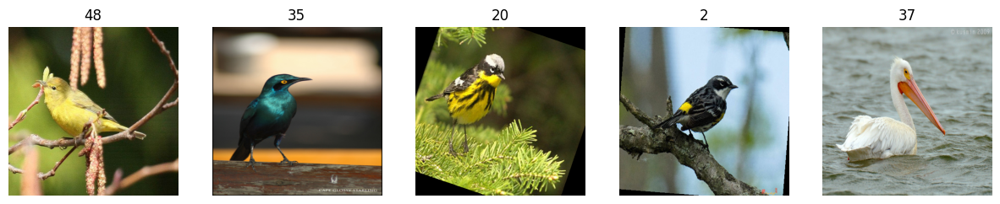

Epoch 19
Train Loss: 0.0000, Validation Loss: 0.3002, Validation Accuracy: 93.92%

[FINAL with Augmentation] Test Loss: 0.3654, Accuracy: 92.2819%
Best Accuracy: 94.26%
Elapsed Time: 3h, 20m, 32s
time: 3h, 200m, 32s


In [ ]:
### Main ###
start = time.time()
best = 0

### wandb ###
wandb.watch(model, log="all")

for epoch in range(EPOCH):
    # With Augmentation
    train_loss = train(model, train_loader, optimizer, epoch)
    val_loss, val_accuracy = evaluate(model, val_loader)

    # Save best model
    if val_accuracy > best:
        best = val_accuracy
        torch.save(model.state_dict(), "./best_model.pth")

    # augmentation 적용한 이미지 보기
    dataiter = iter(train_loader)
    images, labels = dataiter.__next__()
    fig, axes = plt.subplots(1, 5, figsize=(15, 5))
    for i in range(5):
      image = images[i].numpy().transpose((1, 2, 0))
      image = np.clip(image, 0, 1)
      axes[i].imshow(image)
      axes[i].set_title(labels[i].item())
      axes[i].axis('off')
    plt.show()

    # Logging for model without augmentation
    wandb.log({
        'train_loss_with_aug': train_loss.item(),
        'val_loss_with_aug': val_loss,
        'val_accuracy_with_aug': val_accuracy,
    })

    print(f'Epoch {epoch}')
    print(f"Train Loss: {train_loss.item():.4f}, Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%")
    print("")

# Test results
test_loss, test_accuracy = evaluate(model, test_loader)

wandb.log({'test_accuracy_with_aug': test_accuracy})

print(f'[FINAL with Augmentation] Test Loss: {test_loss:.4f}, Accuracy: {test_accuracy:.4f}%')

end = time.time()
elasped_time = end - start
print(f"Best Accuracy: {best:.2f}%")
print(f"Elapsed Time: {int(elasped_time/3600)}h, {int((elasped_time%3600)/60)}m, {int(elasped_time%60)}s")
print(f"time: {int (elasped_time/3600)}h, {int(elasped_time/60)}m, {int(elasped_time%60)}s")

In [ ]:
torch.save(model.state_dict(), "./model_state_dict.pt")

In [ ]:
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 20.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.4.8-py3-none-any.whl size=38244 sha256=18e589c023886417560ec1e5d8cb071af622923faa63d1dd92521ee5082e7ed3
  Stored in directory: /root/.cache/pip/wheels/f8/04/36/94ff3c8a4215826a21946b34c01180817e606989fdf53f7cd6
Successfully built grad-cam


Test Loss: 0.3654, Accuracy: 92.2819%


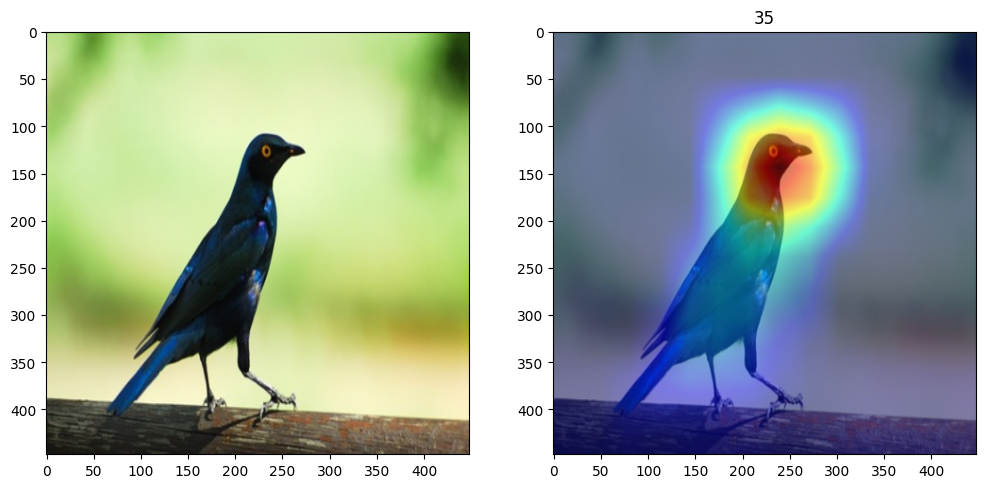

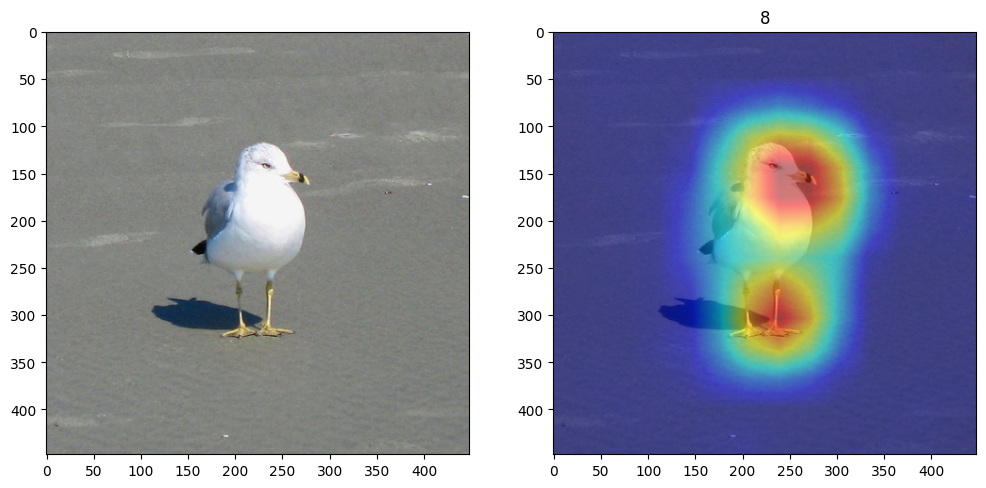

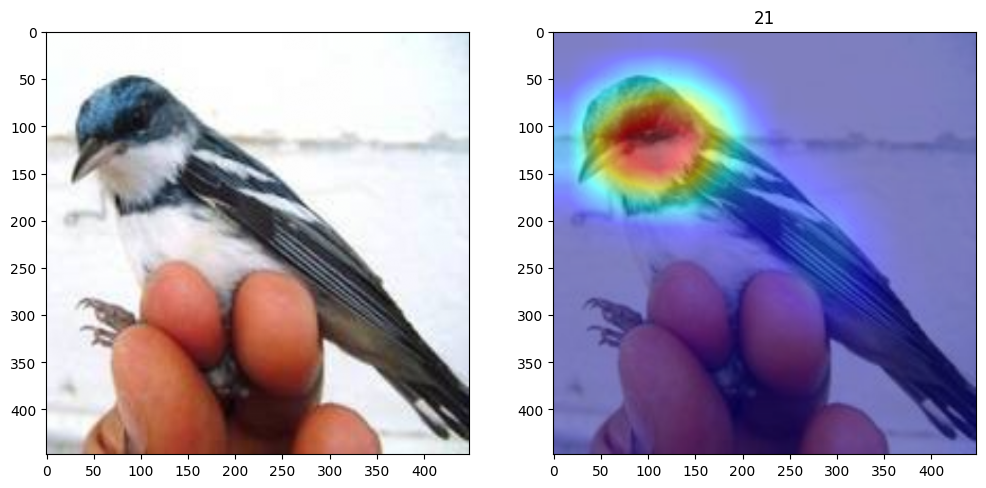

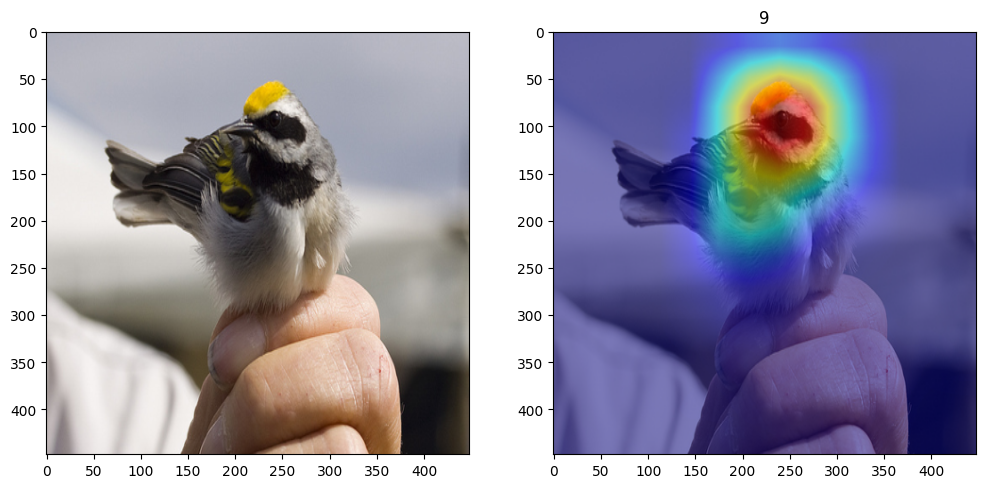

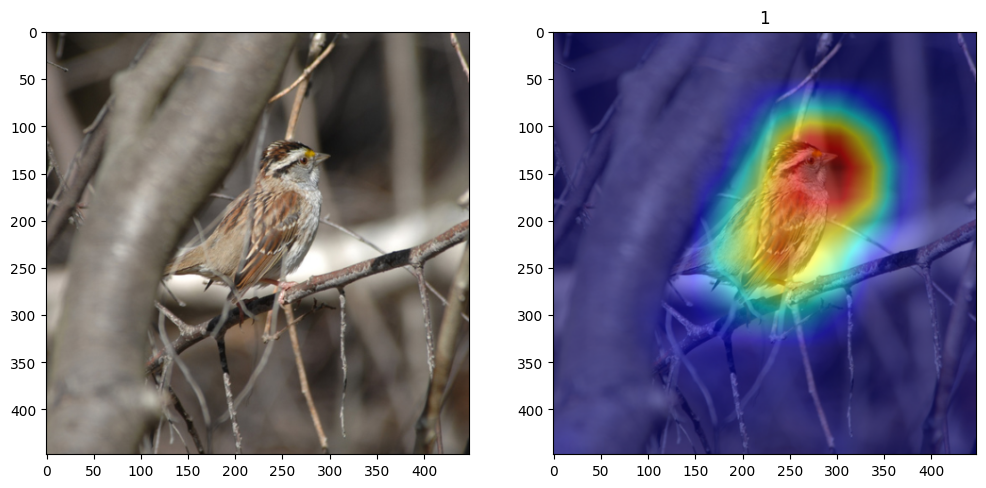

...

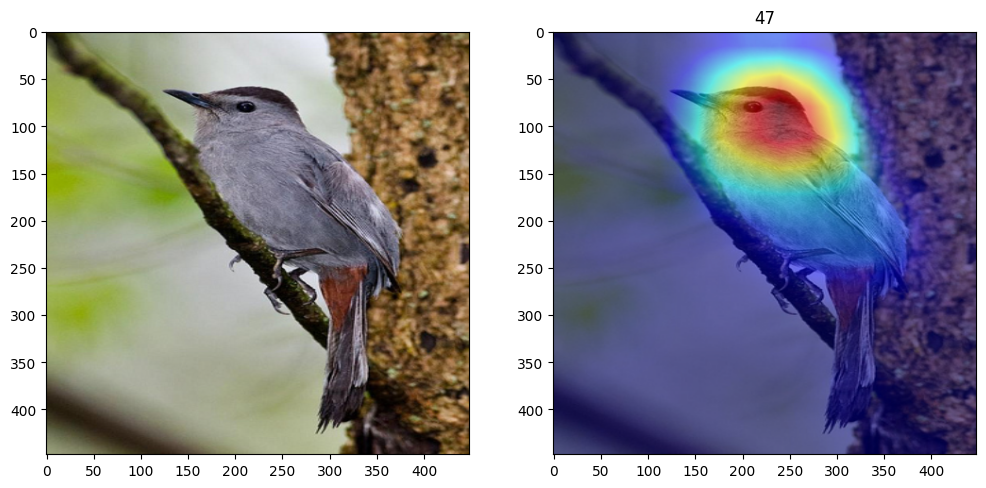

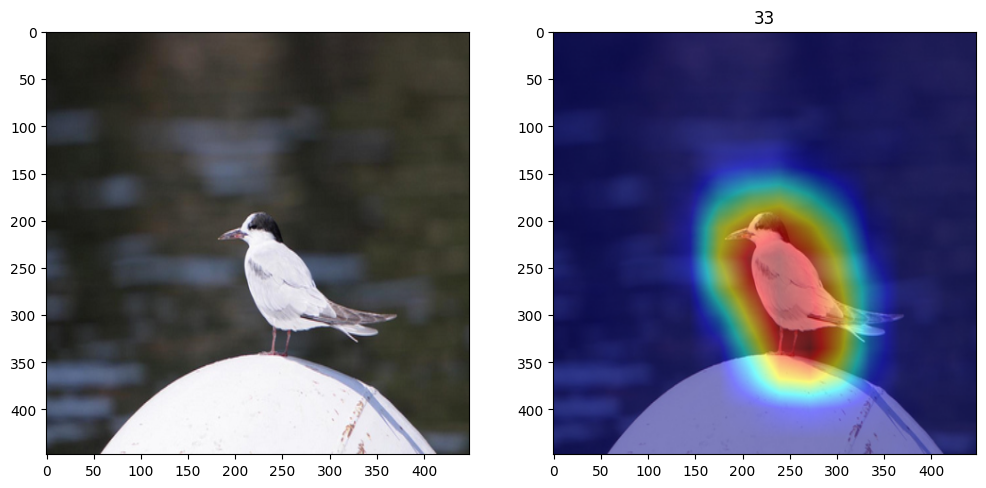

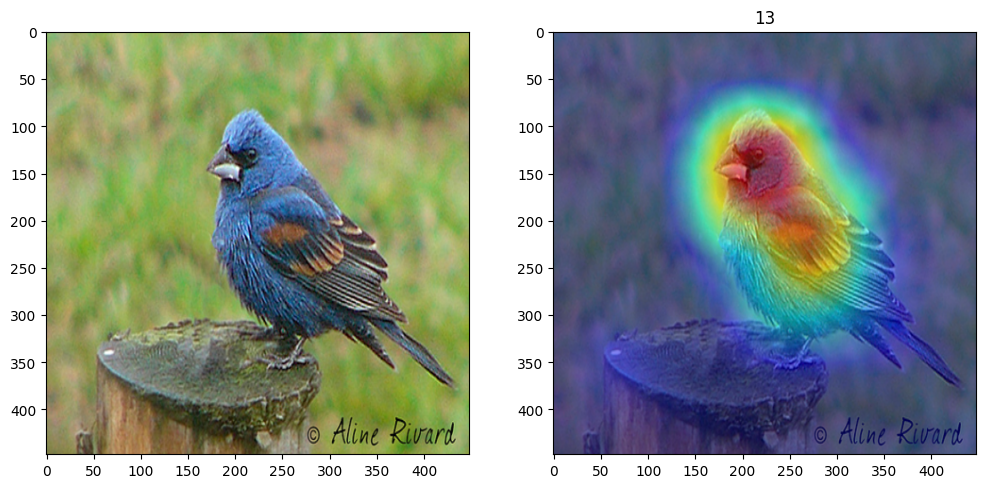

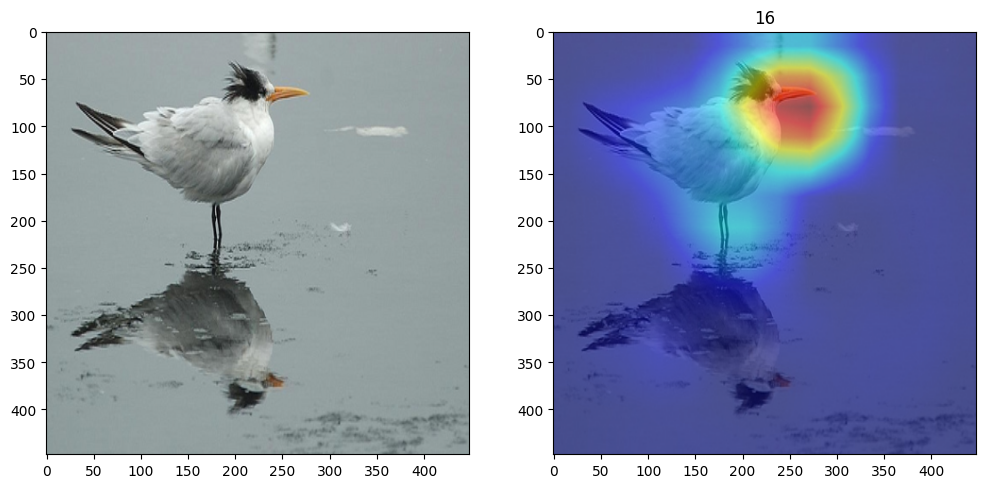

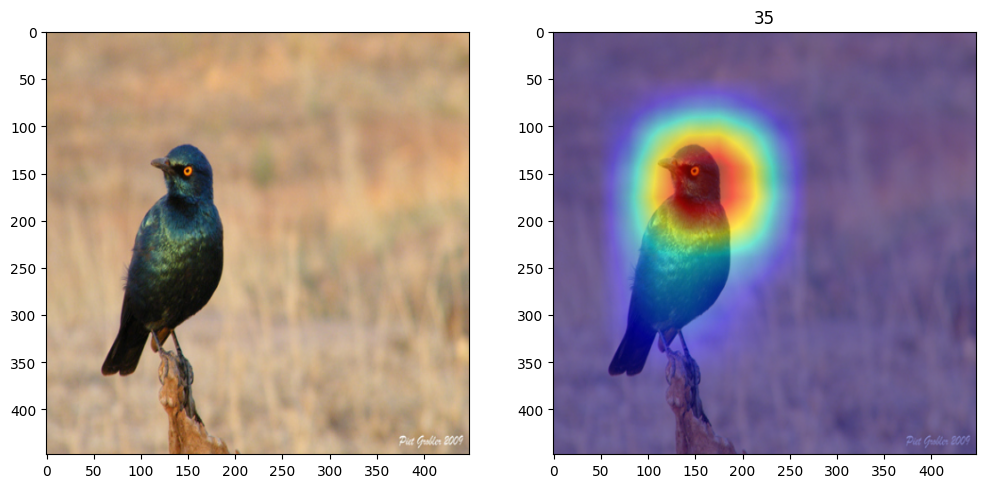

In [ ]:
import copy
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from torchvision.models import resnet18
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as T
from matplotlib import pyplot as plt
"""
model = model_
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, 50)
model = model.to(DEVICE)
optimizer = optim.SGD(model.parameters(), lr=lr)

model.load_state_dict(torch.load("model_state_dict.pt"))
model.eval()
"""

test_loss, test_accuracy = evaluate(model, test_loader)


print(f'Test Loss: {test_loss:.4f}, Accuracy: {test_accuracy:.4f}%')


def gradCAM_func(num):
  image_tensor, label = combined_train_set[num]
  transform = T.ToPILImage()
  rgb_img = transform(image_tensor)
  target_layers = [model.layer4[-1]]
  # Max min normalization
  rgb_img = (rgb_img - np.min(rgb_img)) / (np.max(rgb_img) - np.min(rgb_img))
  # Create an input tensor image for your model
  input_tensor = torchvision.transforms.functional.to_tensor(rgb_img).unsqueeze(0).float()
  # Note: input_tensor can be a batch tensor with several images!

  # Construct the CAM object once, and then re-use it on many images:
  cam = GradCAM(model=model, target_layers=target_layers, use_cuda=True)

  grayscale_cam = cam(input_tensor=input_tensor)

  # In this example grayscale_cam has only one image in the batch:
  grayscale_cam = grayscale_cam[0, :]
  visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  Image.fromarray(visualization, 'RGB')
  fig, ax = plt.subplots(1, 2, figsize=(12, 6))

  # Display the image using imshow
  ax[0].imshow(rgb_img)
  ax[1].imshow(visualization)

  # Show the plot
  plt.title(label)
  plt.show()

  # Image.fromarray(visualization, 'RGB')

# 괄호 안에 아무 수나 넣고 테스트하면 됩니다.
for i in range(200):
  if i % 10 == 0:
    gradCAM_func(i)